<a href="https://colab.research.google.com/github/priyankagaikwad20/Diabetic-Retinopathy-Detection/blob/main/DiabeticRetinopathy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
 !pip install google-colab
 from google.colab import drive
drive.mount('/content/gdrive')
try:
  drive.mount('/content/gdrive')
except MessageError as e:
  print(e)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 16.3 MB/s eta 0:00:00
Mounted at /content/gdrive
Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import seaborn as sns

import random
import os
import gc  # garbage collector
import datetime
from tqdm import tqdm

import cv2
from sklearn.preprocessing import StandardScaler as scale
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score

import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, Dense, Flatten, MaxPooling2D, BatchNormalization, Dropout, GlobalAveragePooling2D
from tensorflow.keras.callbacks import EarlyStopping, CSVLogger, ModelCheckpoint, TensorBoard
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import NASNetLarge

In [ ]:
resized_train_path ="/content/gdrive/MyDrive/diabetic retinopathy/resized_train"
train_labels_path = "/content/gdrive/MyDrive/diabetic retinopathy/trainLabels (3).csv"
train_labels_cropped_path = "/content/gdrive/MyDrive/diabetic retinopathy/trainLabels_cropped (2).csv"

In [ ]:
train_labels = pd.read_csv(train_labels_path)
train_labels.head()

,image,level
0,10_left,0
1,10_right,0
2,13_left,0
3,13_right,0
4,15_left,1


In [ ]:
train_labels.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35126 entries, 0 to 35125
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   35126 non-null  object
 1   level   35126 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 549.0+ KB


In [ ]:
level_cropped_col = train_labels['level']
level_cropped_col

0        0
1        0
2        0
3        0
4        1
        ..
35121    0
35122    0
35123    0
35124    0
35125    1
Name: level, Length: 35126, dtype: int64

<ipython-input-8-814655c187f2>:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  level_cropped_col.plot(kind='hist', figsize=(10, 5), cmap=cm.get_cmap('flag'))


<Axes: ylabel='Frequency'>

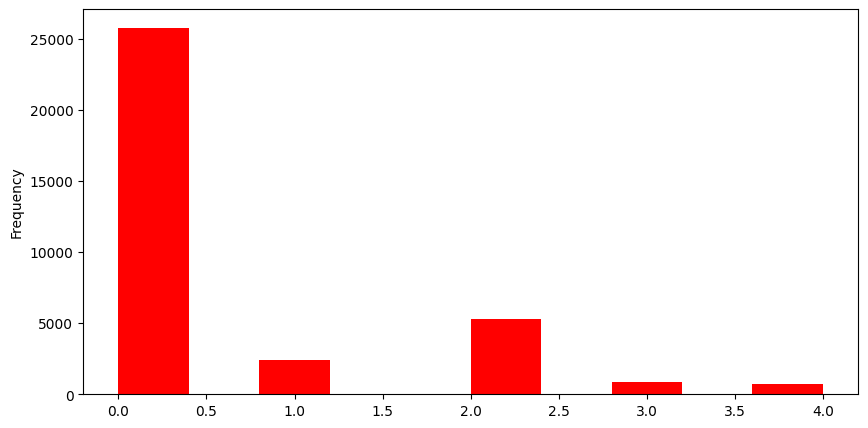

In [ ]:
level_cropped_col.plot(kind='hist', figsize=(10, 5), cmap=cm.get_cmap('flag'))


In [ ]:
train_labels_cropped = pd.read_csv(train_labels_cropped_path)
train_labels_cropped

,Unnamed: 0.1,Unnamed: 0,image,level
0,0,0,10_left,0
1,1,1,10_right,0
2,2,2,13_left,0
3,3,3,13_right,0
4,4,4,15_left,1
...,...,...,...,...
35103,35104,35121,44347_right,0
35104,35105,35122,44348_left,0
35105,35106,35123,44348_right,0
35106,35107,35124,44349_left,0


In [ ]:
level_cropped_col = train_labels_cropped['level']
level_cropped_col

0        0
1        0
2        0
3        0
4        1
        ..
35103    0
35104    0
35105    0
35106    0
35107    1
Name: level, Length: 35108, dtype: int64

<ipython-input-11-eb36bbd38c09>:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  level_cropped_col.plot(kind='hist', figsize=(10, 5), cmap=cm.get_cmap('ocean'))


<Axes: ylabel='Frequency'>

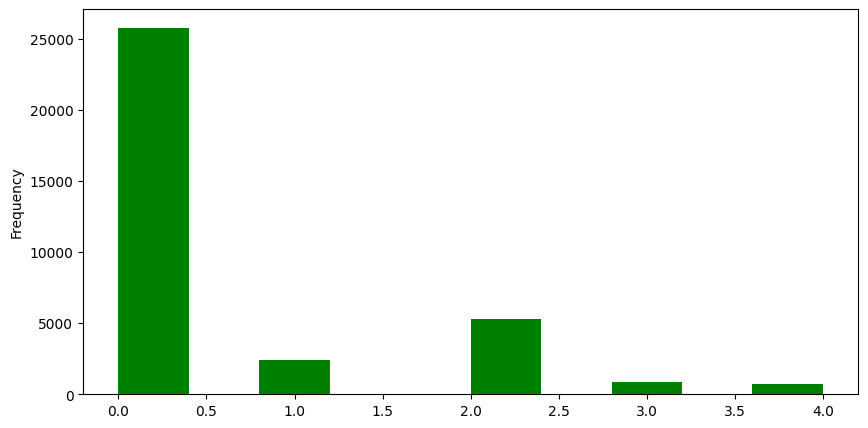

In [ ]:
level_cropped_col.plot(kind='hist', figsize=(10, 5), cmap=cm.get_cmap('ocean'))

In [ ]:
resized_train_list = os.listdir(resized_train_path)
len(resized_train_list)

3290

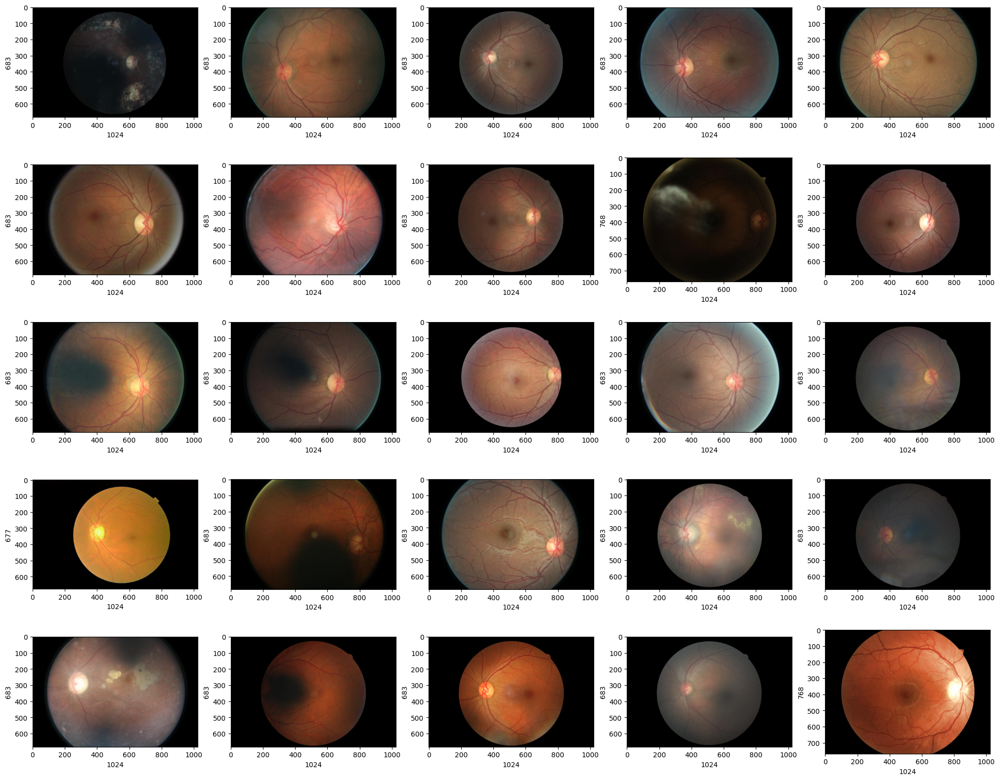

In [ ]:
plt.figure(figsize=(25, 20))
for i in range(1, 26):
    plt.subplot(5, 5, i)
    img_name = random.choice(resized_train_list)
    img_path = os.path.join(resized_train_path, img_name)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.xlabel(img.shape[1])
    plt.ylabel(img.shape[0])

In [ ]:
resized_train_cropped_path ='/content/gdrive/MyDrive/diabetic retinopathy/resized_train_cropped'

In [ ]:
resized_train_cropped_list = os.listdir(resized_train_cropped_path)
len(resized_train_cropped_list)

1021

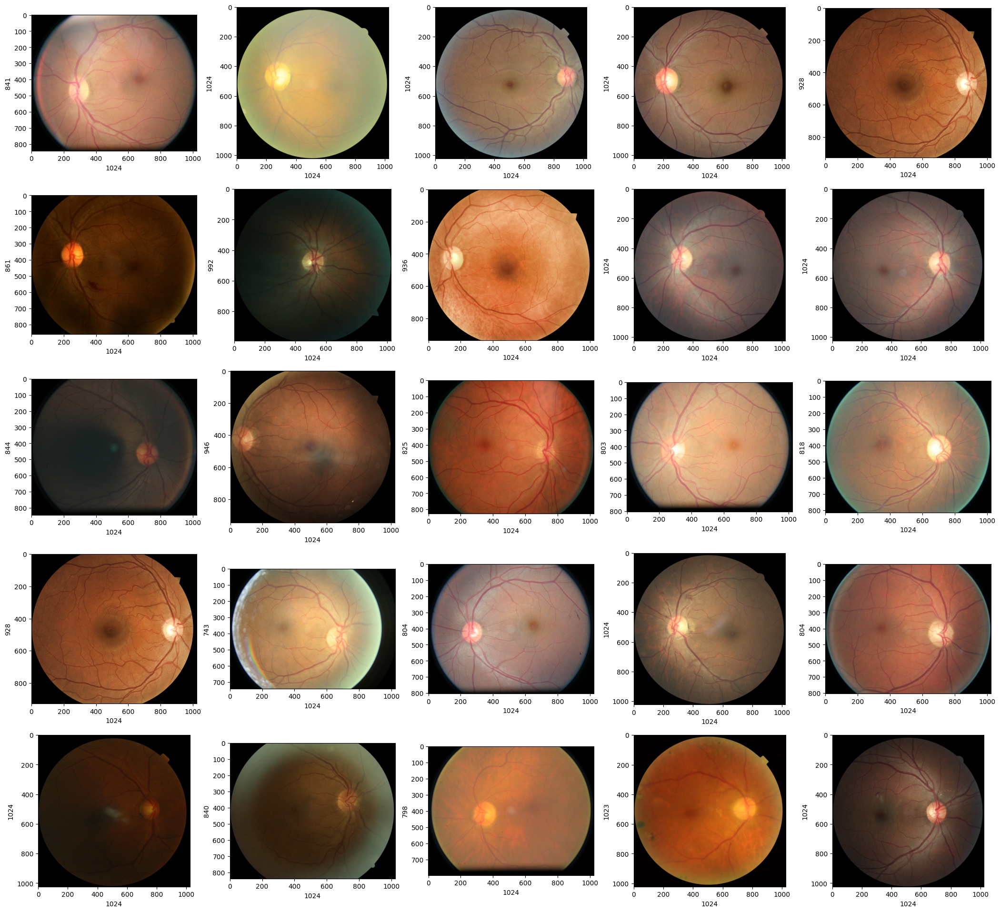

In [ ]:
plt.figure(figsize=(26, 24))
for i in range(1, 26):
    plt.subplot(5, 5, i)
    img_name = random.choice(resized_train_cropped_list)
    img_path = os.path.join(resized_train_cropped_path, img_name)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.xlabel(img.shape[1])
    plt.ylabel(img.shape[0])

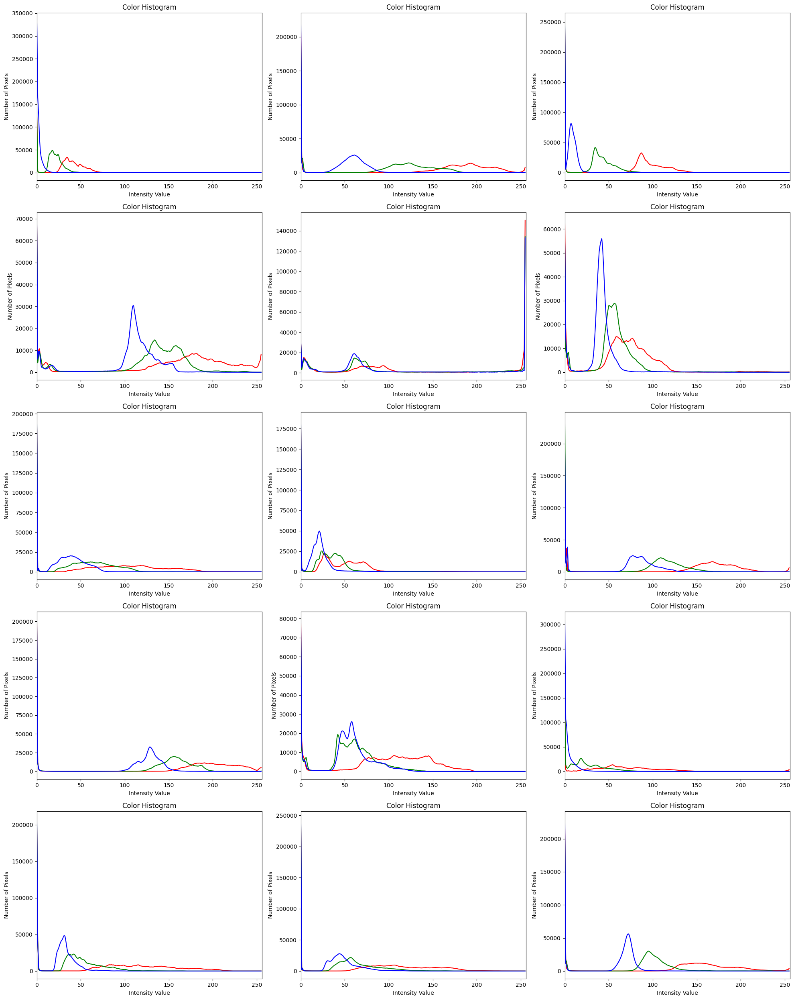

In [ ]:
plt.figure(figsize=(20, 25))
for i in range(1, 16):
    plt.subplot(5, 3, i)
    plt.tight_layout()
    plt.title("Color Histogram")
    plt.xlabel("Intensity Value")
    plt.ylabel("Number of Pixels")
    img_name = random.choice(resized_train_cropped_list)
    img_path = os.path.join(resized_train_cropped_path, img_name)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    channels = cv2.split(img)
    colors = ['r', 'g', 'b']
    for (channel, color) in zip(channels, colors):
        hist = cv2.calcHist([channel], [0], None, [256], [0, 256])
        plt.plot(hist, color=color)
        plt.xlim([0, 256])

In [ ]:
img_width = 100
img_height = 100

def read_img(img_name, resize=False):
    img_path = os.path.join(resized_train_cropped_path, img_name)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    if resize:
        img = cv2.resize(img, (img_width, img_hight))

    return img

In [ ]:
def ben_graham(img):
    img_ben = cv2.addWeighted(img, 4, cv2.GaussianBlur(img, (0, 0), 10), -4, 128)
    return img_ben

In [ ]:
def hist_equalization(img):
    red, green, blue = cv2.split(img)
    hist_red = cv2.equalizeHist(red)
    hist_green = cv2.equalizeHist(green)
    hist_blue = cv2.equalizeHist(blue)

    img_eq = cv2.merge((hist_red, hist_green, hist_blue))

    return img_eq

In [ ]:
equal_hist_images = resized_train_cropped_list.copy()
len(equal_hist_images)

1021

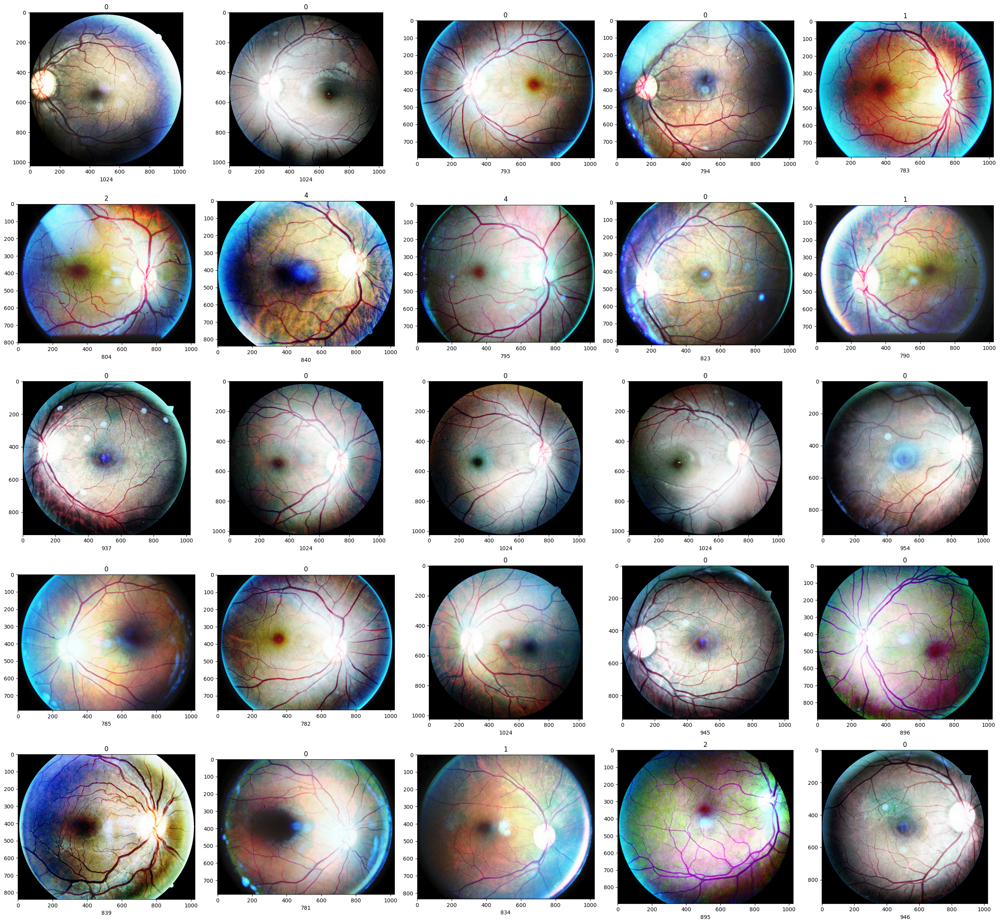

In [ ]:
108
plt.figure(figsize=(26, 24))
counter = 0
for img_name in equal_hist_images:
    counter += 1
    plt.subplot(5, 5, counter)
    plt.tight_layout()
    # level_cropped_col is the labels, we've created it above
    plt.title(level_cropped_col[counter - 1])

    img = read_img(img_name)

    # Applying the Histogram Equaliztion
    img_eq = hist_equalization(img)
    plt.imshow(img_eq)
    plt.xlabel(img_eq.shape[1])
    plt.xlabel(img_eq.shape[0])

    if counter == 25:
        break

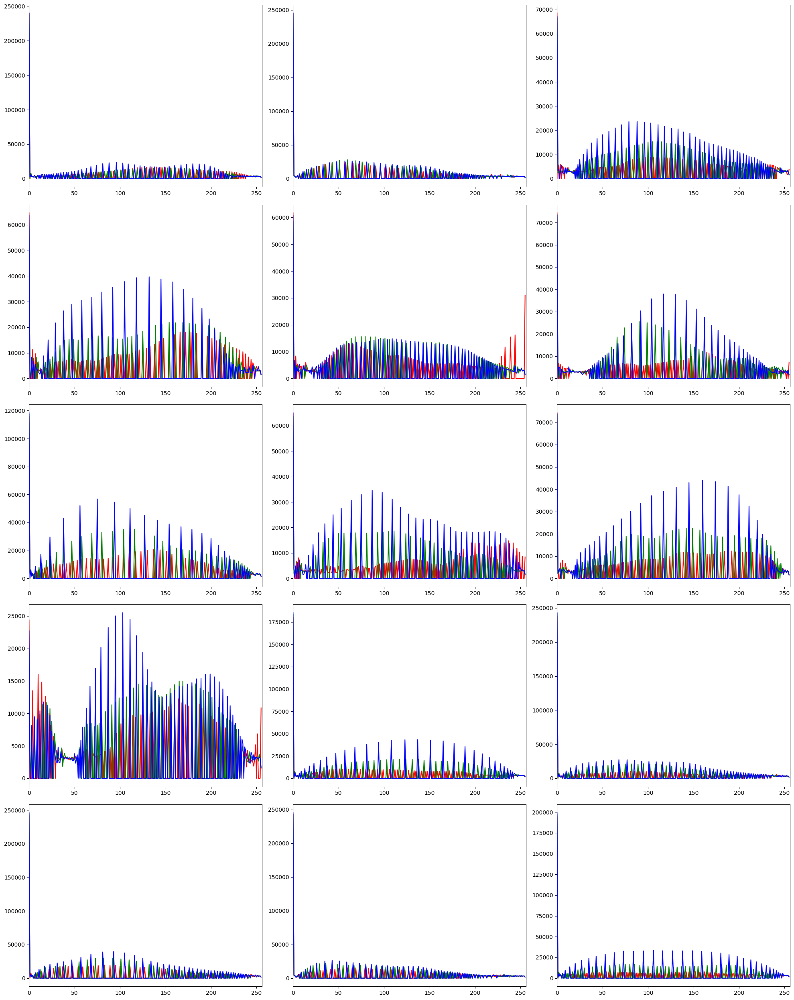

In [ ]:
plt.figure(figsize=(20, 25))
counter = 0
for img_name in equal_hist_images:
    counter += 1
    plt.subplot(5, 3, counter)
    plt.tight_layout()

    img = read_img(img_name)

    # Applying the Histogram Equaliztion
    img_eq = hist_equalization(img)

    channels = cv2.split(img_eq)
    colors = ['r', 'g', 'b']

    for (channel, color) in zip(channels, colors):
        hist = cv2.calcHist([channel], [0], None, [256], [0, 256])
        plt.plot(hist, color=color)
        plt.xlim([0, 256])

    if counter == 15:
        break

In [ ]:
ben_images = resized_train_cropped_list.copy()
len(ben_images)

1021

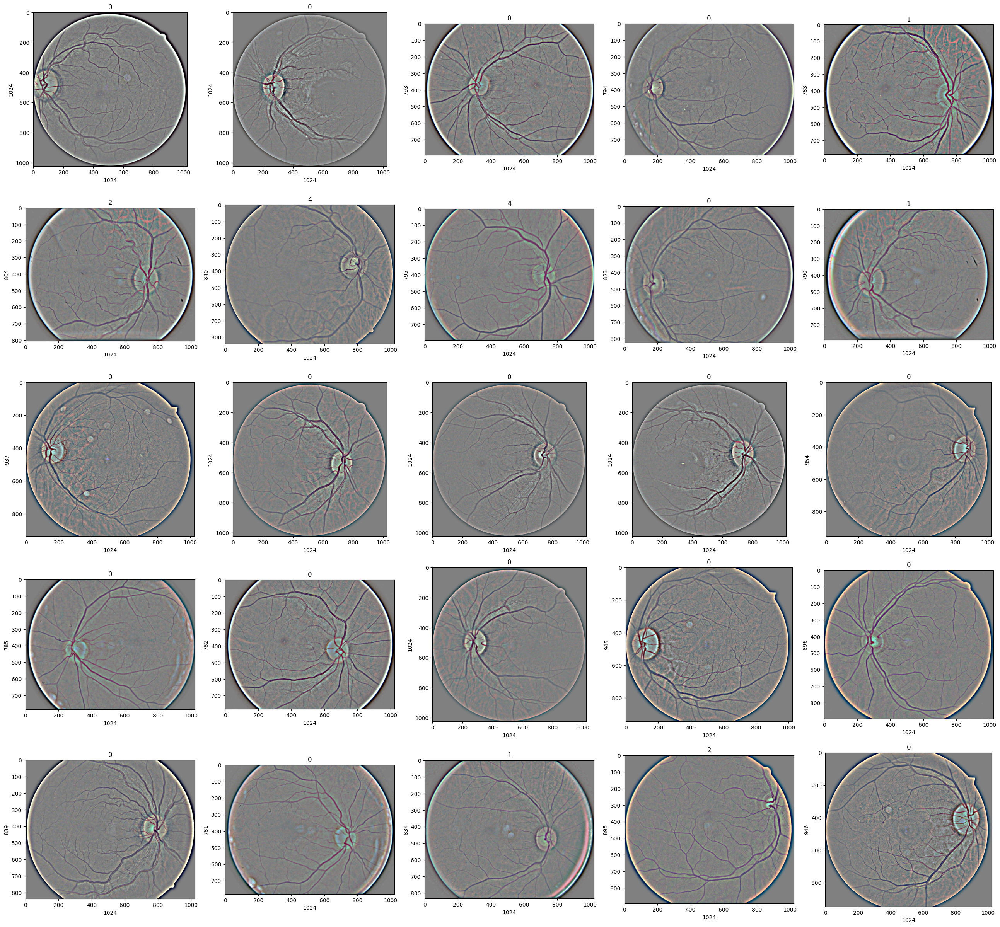

In [ ]:
plt.figure(figsize=(26, 24))
counter = 0
for img_name in ben_images:
    counter += 1
    plt.subplot(5, 5, counter)
    plt.tight_layout()
    # level_cropped_col is the lebels list
    plt.title(level_cropped_col[counter - 1])

    img = read_img(img_name)

    # Applying Ben Graham's Method
    img_ben = ben_graham(img)

    plt.imshow(img_ben)
    plt.xlabel(img_ben.shape[1])
    plt.ylabel(img_ben.shape[0])

    if counter == 25:
        break

In [ ]:
plt.figure(figsize=(20, 25))
counter = 0
for img_name in equal_hist_images:
    counter += 1
    plt.subplot(5, 3, counter)
    plt.tight_layout()

    img = read_img(img_name)

    # Applying Ben Graham's Method
    img_ben = ben_graham(img)

    channels = cv2.split(img_ben)
    colors = ['r', 'g', 'b']

    for (channel, color) in zip(channels, colors):
        hist = cv2.calcHist([channel], [0], None, [256], [0, 256])
        plt.plot(hist, color=color)
        plt.xlim([0, 256])

    if counter == 15:
        break

In [ ]:
train_labels_cropped.head()

In [ ]:
train_labels_cropped['image_name'] = [img + '.jpeg' for img in train_labels_cropped['image']]
train_labels_cropped.head()

In [ ]:
train_ds, val_ds = train_test_split(train_labels_cropped, test_size=0.5)
train_ds.shape, val_ds.shape

In [ ]:
def my_processes(img):
    img = cv2.resize(img, (img_width, img_height))

    # Apply your image processing method
    img = ben_graham(img)

    return img

In [ ]:
train_datagen = ImageDataGenerator(rescale = 1./255.,
                                  rotation_range = 40,
                                  width_shift_range = 0.5,
                                  height_shift_range = 0.5,
                                  shear_range = 0.5,
                                  horizontal_flip = True,
                                  preprocessing_function=ben_graham)

In [ ]:
val_datagen = ImageDataGenerator(rescale = 1./255.)

In [ ]:
batch_size = 64

train_dataset = train_datagen.flow_from_dataframe(train_ds,
                                                 resized_train_cropped_path,
                                                 x_col="image_name",
                                                 y_col="level",
                                                 class_mode='raw',
                                                 batch_size=batch_size,
                                                 target_size=(img_width, img_height))
val_dataset = val_datagen.flow_from_dataframe(val_ds,
                                             resized_train_cropped_path,
                                             x_col='image_name',
                                             y_col='level',
                                             class_mode='raw',
                                             batch_size=batch_size,
                                             target_size=(img_width, img_height))

In [ ]:
model = tf.keras.applications.nasnet.NASNetLarge(
    input_shape=None,
    include_top=True,
    weights='imagenet',
    input_tensor=None,
    pooling=None,
    classes=1000,
    classifier_activation='softmax'
)

In [ ]:
x = Dropout(0.2)(model.output)
x = Dropout(0.5)(x)

x = Dense(2048, activation='relu')(x)
x = Dense(2048, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dropout(0.5)(model.output)

x = Dense(1024, activation='relu')(x)
x = Dense(1024, activation='relu')(x)
x = Dropout(0.5)(x)

x = Dense(1024, activation='relu')(x)
x = Dropout(0.1)(x)

x = Dense(1024, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(512, activation='relu')(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.2)(x)

x = Dense(512, activation='relu')(x)
x = Dropout(0.1)(x)

x = Dense(512, activation='relu')(x)
x = Dropout(0.1)(x)


#x = GlobalAveragePooling2D()(x)
#x = Dropout(0.1)(x)
classifier = Dense(5, activation='softmax')(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.1)(x)

x = Dense(512, activation='relu')(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.2)(x)

x = Dense(512, activation='relu')(x)
x = Dropout(0.1)(x)

x = Dense(512, activation='relu')(x)
classifier = Dropout(0.1)(x)


model = Model(inputs = model.input, outputs=classifier)

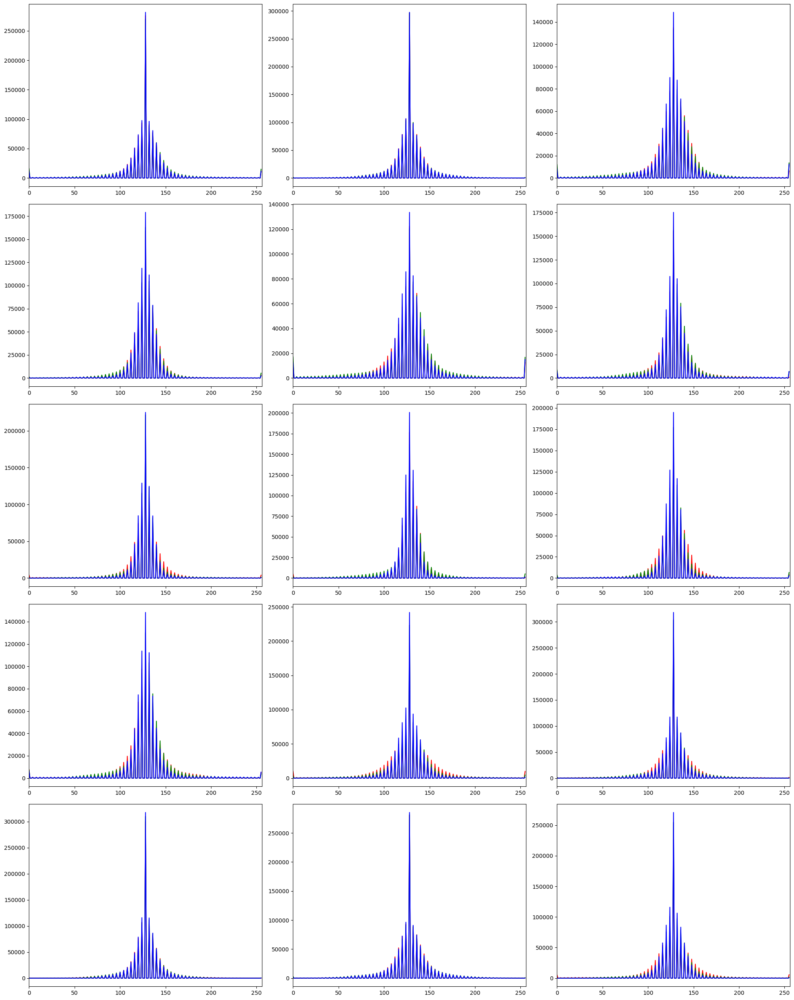

In [ ]:
plt.figure(figsize=(20, 25))
counter = 0
for img_name in equal_hist_images:
    counter += 1
    plt.subplot(5, 3, counter)
    plt.tight_layout()

    img = read_img(img_name)

    # Applying Ben Graham's Method
    img_ben = ben_graham(img)

    channels = cv2.split(img_ben)
    colors = ['r', 'g', 'b']

    for (channel, color) in zip(channels, colors):
        hist = cv2.calcHist([channel], [0], None, [256], [0, 256])
        plt.plot(hist, color=color)
        plt.xlim([0, 256])

    if counter == 15:
        break

In [ ]:
pip install opencv-python-headless numpy matplotlib

In [ ]:
train_datagen = ImageDataGenerator(
    preprocessing_function=prepare_image,
    rescale=1./255.,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

val_datagen = ImageDataGenerator(
    preprocessing_function=prepare_image,
    rescale=1./255.
)


In [ ]:
from tensorflow.keras.regularizers import l2

model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3), kernel_regularizer=l2(0.01)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_regularizer=l2(0.01)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_regularizer=l2(0.01)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512, activation='relu', kernel_regularizer=l2(0.01)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(5, activation='softmax')
])


In [ ]:
from tensorflow.keras.callbacks import ReduceLROnPlateau

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.00001)


In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)


In [ ]:
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    loss='sparse_categorical_crossentropy',
    metrics=['sparse_categorical_accuracy']
)


Validated 126 training images and 28 validation images.
Found 126 validated image filenames.
Found 28 validated image filenames.
Epoch 1/100
4/4 [==============================] - ETA: 0s - loss: 9.0427 - sparse_categorical_accuracy: 0.5000 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


4/4 [==============================] - 49s 11s/step - loss: 9.0427 - sparse_categorical_accuracy: 0.5000 - val_loss: 2.3543 - val_sparse_categorical_accuracy: 0.0714 - lr: 0.0010
Epoch 2/100
4/4 [==============================] - 15s 4s/step - loss: 2.8342 - sparse_categorical_accuracy: 0.4444 - val_loss: 0.6967 - val_sparse_categorical_accuracy: 0.8929 - lr: 0.0010
Epoch 3/100
4/4 [==============================] - 15s 4s/step - loss: 1.0991 - sparse_categorical_accuracy: 0.5476 - val_loss: 0.8150 - val_sparse_categorical_accuracy: 0.8929 - lr: 0.0010
Epoch 4/100
4/4 [==============================] - 17s 4s/step - loss: 0.9652 - sparse_categorical_accuracy: 0.6825 - val_loss: 0.5540 - val_sparse_categorical_accuracy: 0.8929 - lr: 0.0010
Epoch 5/100
4/4 [==============================] - 14s 3s/step - loss: 0.9161 - sparse_categorical_accuracy: 0.6825 - val_loss: 0.5590 - val_sparse_categorical_accuracy: 0.8929 - lr: 0.0010
Epoch 6/100
4/4 [==============================] - 14s 3s/ste

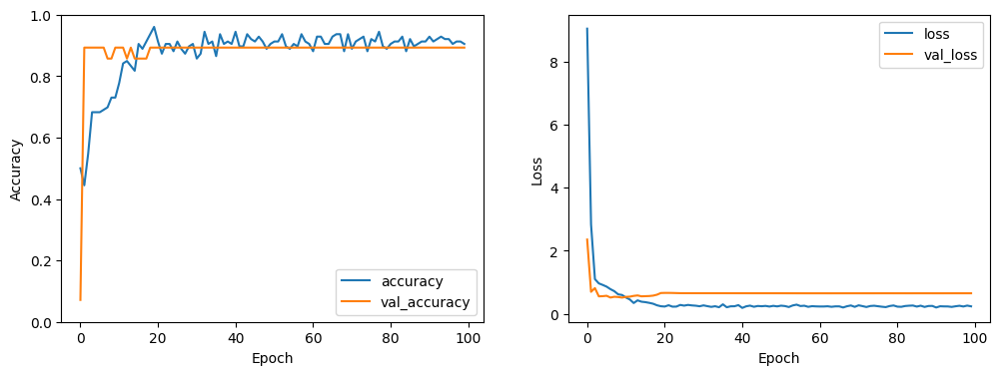

In [ ]:
import numpy as np
import pandas as pd
import cv2
import os
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint

# Preprocessing function to prepare the image
def prepare_image(image, sigmaX=10):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, (224, 224))
    image = cv2.addWeighted(image, 4, cv2.GaussianBlur(image, (0, 0), sigmaX), -4, 128)
    return image

# Ensure that the image filenames exist in the directory
def validate_filenames(df, image_dir, image_col='image_name'):
    valid_filenames = [f for f in df[image_col] if os.path.isfile(os.path.join(image_dir, f))]
    valid_df = df[df[image_col].isin(valid_filenames)].reset_index(drop=True)
    return valid_df

# Load the CSV file
data = pd.read_csv("/content/gdrive/MyDrive/diabetic retinopathy/trainLabels_cropped (2).csv")

# Create a list of image names with .jpeg extension
data['image_name'] = data['image'] + '.jpeg'

# Drop unnecessary columns
data.drop(columns=['Unnamed: 0.1', 'Unnamed: 0', 'image'], inplace=True)

# Sample 5000 random rows from the dataframe
random_rows = data.sample(n=5000, random_state=42)

# Split the sampled rows into training and test sets
train, test = train_test_split(random_rows, test_size=0.2, random_state=42)

# Directory where images are stored
image_dir = '/content/gdrive/MyDrive/diabetic retinopathy/resized_train_cropped'

# Validate filenames in train and test dataframes
train = validate_filenames(train, image_dir)
test = validate_filenames(test, image_dir)

print(f"Validated {len(train)} training images and {len(test)} validation images.")

# Define the ImageDataGenerator with rescaling and preprocessing function
train_datagen = ImageDataGenerator(
    preprocessing_function=prepare_image,
    rescale=1./255.
)

val_datagen = ImageDataGenerator(
    preprocessing_function=prepare_image,
    rescale=1./255.
)

# Create the training data generator
train_generator = train_datagen.flow_from_dataframe(
    train,
    directory=image_dir,
    x_col='image_name',
    y_col='level',
    class_mode='raw',
    target_size=(224, 224),
    batch_size=32,
    shuffle=True
)

# Create the validation data generator
val_generator = val_datagen.flow_from_dataframe(
    test,
    directory=image_dir,
    x_col='image_name',
    y_col='level',
    class_mode='raw',
    target_size=(224, 224),
    batch_size=32,
    shuffle=False
)

# Define the model
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(5, activation='softmax')
])

# Compile the model
model.compile(
    optimizer=Adam(learning_rate=0.001),
    loss='sparse_categorical_crossentropy',
    metrics=['sparse_categorical_accuracy']
)

# Define callbacks without EarlyStopping
callbacks = [
    ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, min_lr=1e-6),
    ModelCheckpoint('best_model.h5', monitor='val_loss', save_best_only=True)
]

# Train the model
history = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=100,
    callbacks=callbacks
)

# Plot training history
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['sparse_categorical_accuracy'], label='accuracy')
plt.plot(history.history['val_sparse_categorical_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.show()

# Save the model
model.save('diabetic_retinopathy_model.h5')
